In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from sklearn.model_selection import ParameterGrid
import statsmodels.api as sm
from linearmodels.panel import PooledOLS
from statsmodels.tsa.stattools import adfuller
from linearmodels.panel import PanelOLS
from sklearn.metrics import mean_absolute_percentage_error

Iteration 1 RMSE: 225.19
Iteration 2 RMSE: 65.47
Iteration 3 RMSE: 62.30
Iteration 4 RMSE: 62.30
Iteration 5 RMSE: 62.30

Evaluation Metrics:
Mean Absolute Error: 17.76
Root Mean Squared Error: 106.93
Mean Absolute Percentage Error: 4865038174590048.0000


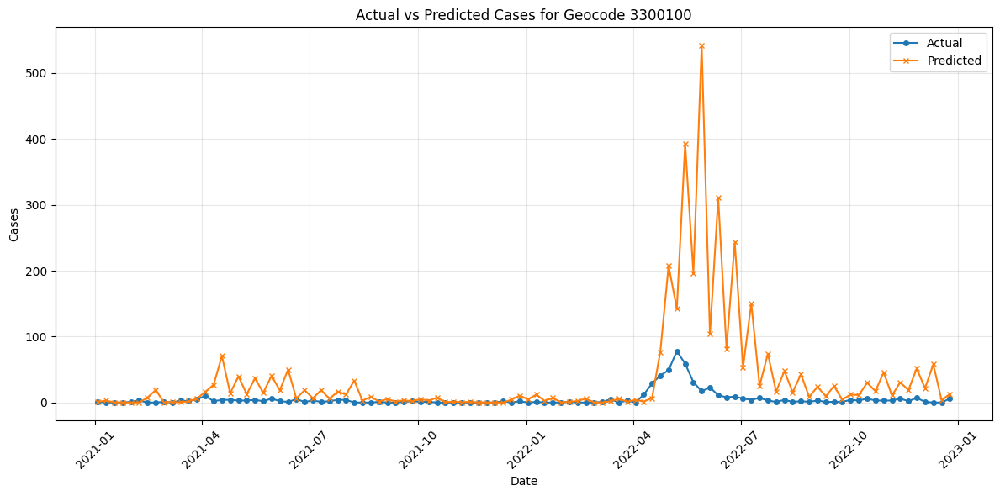

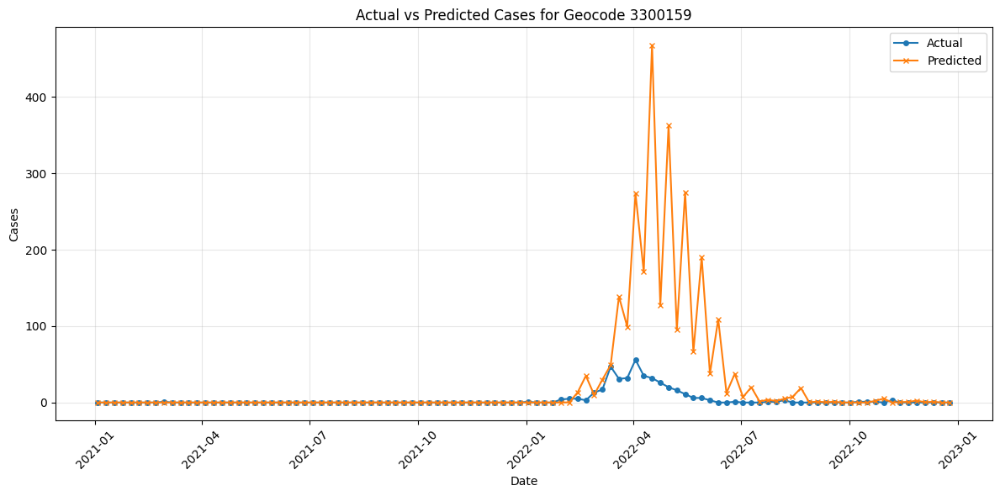

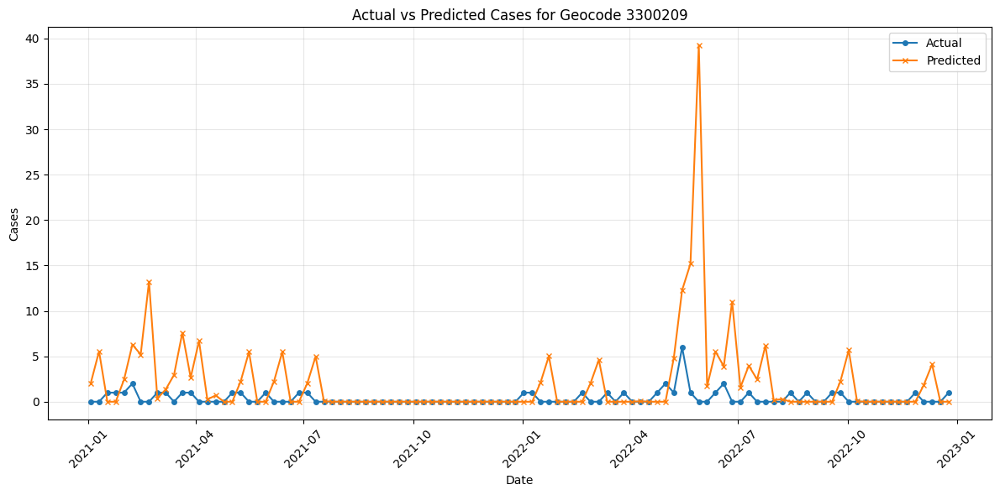

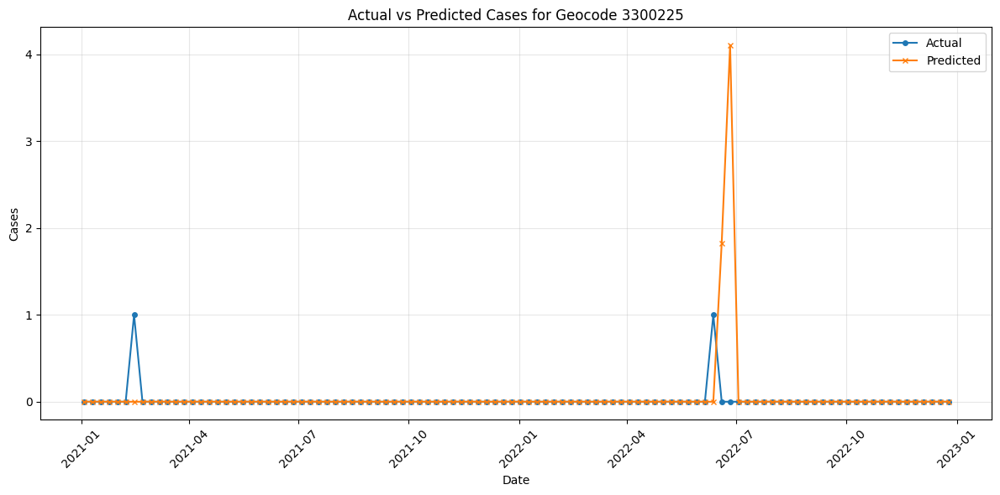

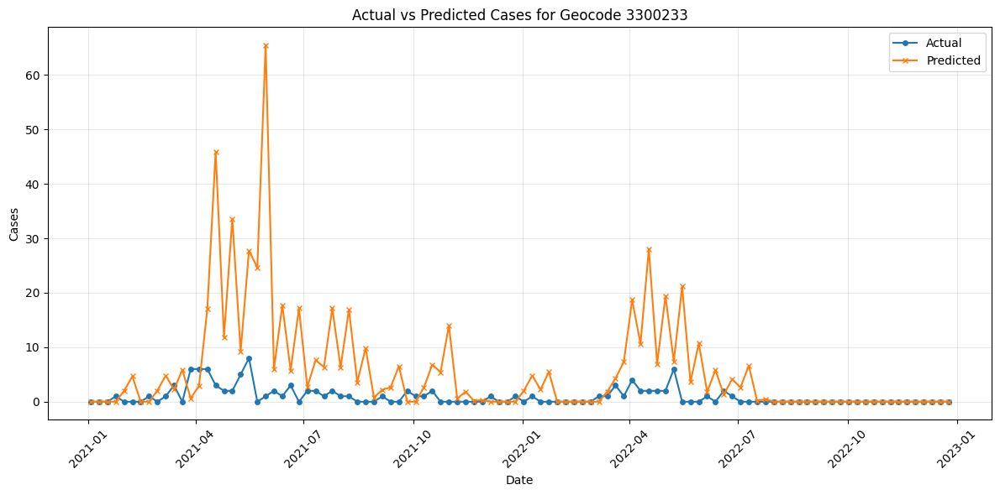

...

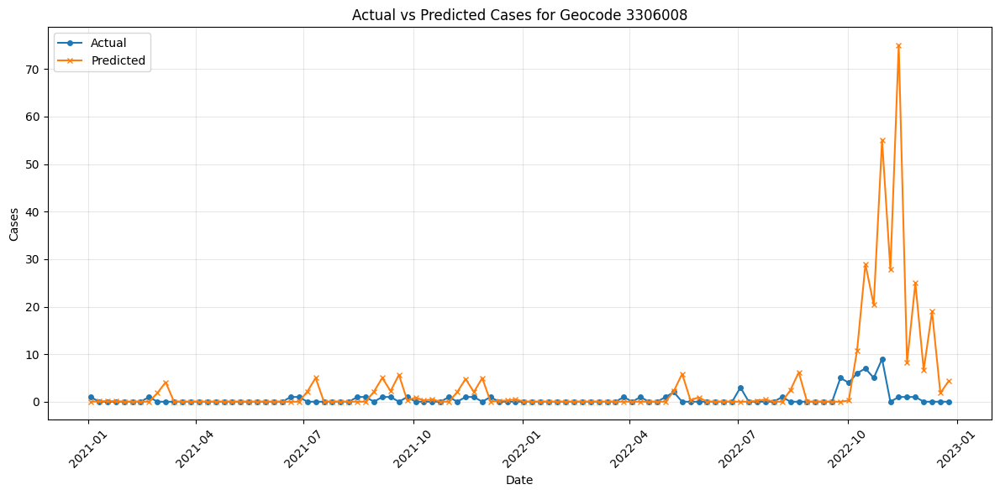

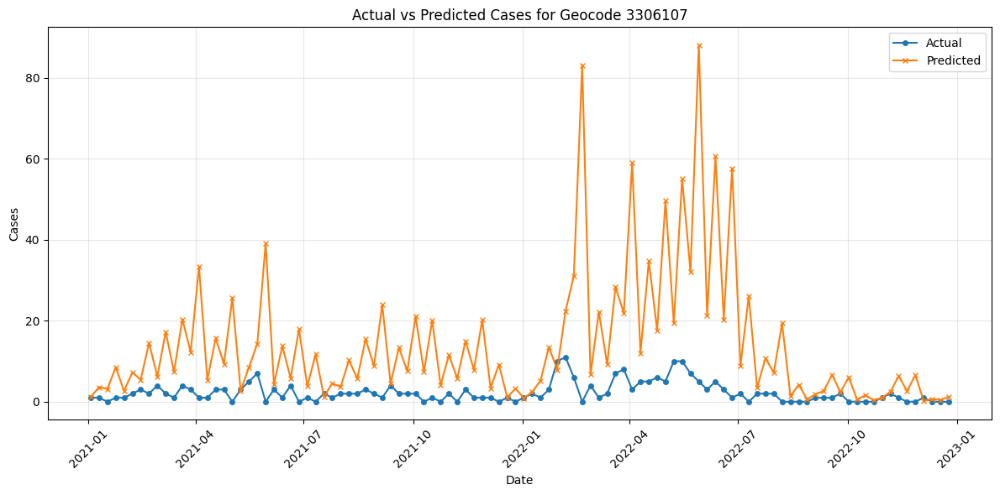

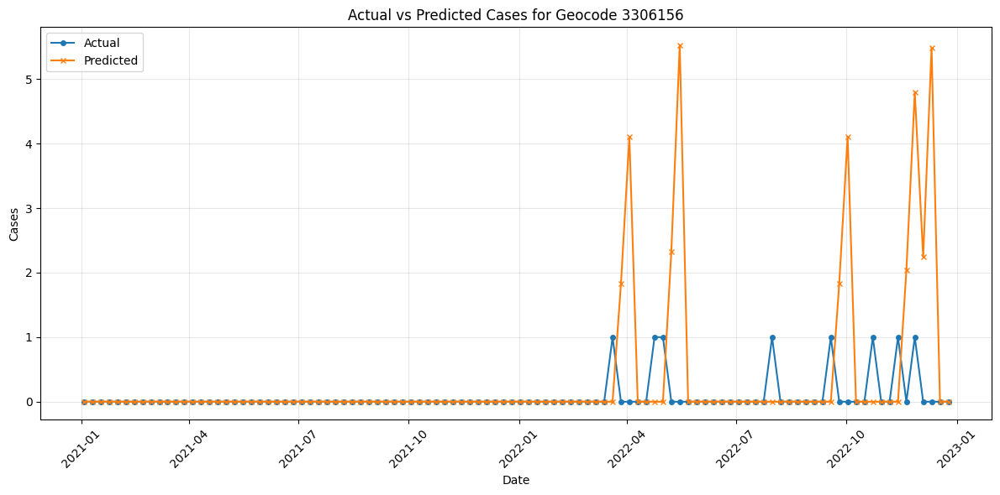

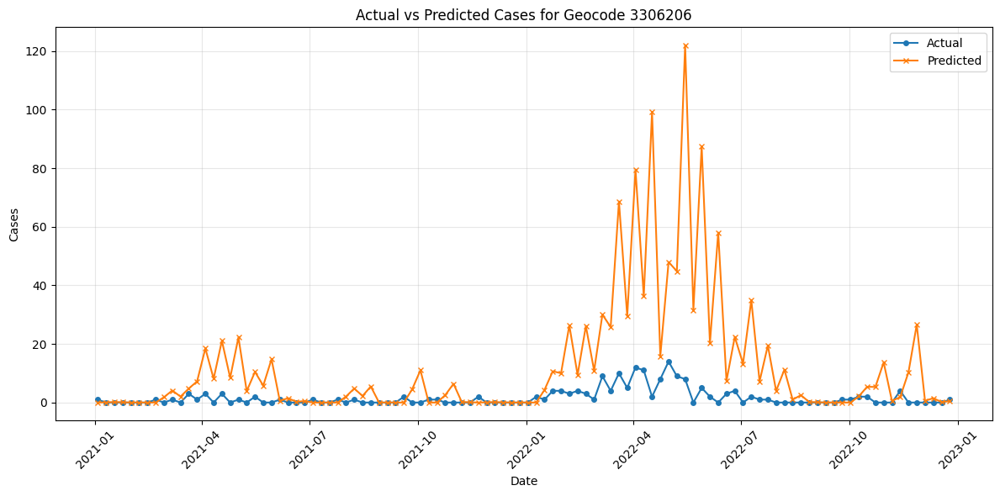

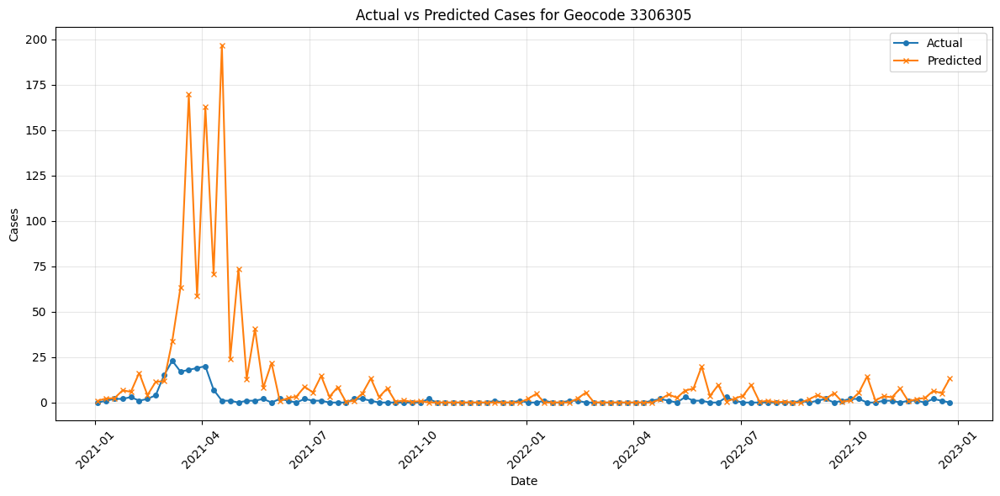

In [9]:

def simulate_rolling_predictions(data, model_result, features, window_size=2):
    """
    Simulates rolling predictions during training to create more realistic feature values
    """
    simulated_data = data.copy()
    
    for geocode in data.index.get_level_values('geocode').unique():
        geocode_data = data.xs(geocode, level='geocode')
        
        # Process each window
        for i in range(0, len(geocode_data) - window_size + 1, window_size):
            window = geocode_data.iloc[i:i+window_size].copy()
            
            # Store predictions for this window
            window_predictions = {}
            
            # Process each time step in the window
            for step in range(window_size):
                current_date = window.index[step]
                
                # Create prediction data
                pred_data = window.iloc[step:step+1][features].copy()
                
                # Update lagged features based on previous predictions
                if step > 0:
                    pred_data['cases_lag1'] = window_predictions[window.index[step-1]]
                
                if step > 1:
                    pred_data['cases_lag2'] = window_predictions[window.index[step-2]]
                
                # Update MA7 based on available values
                recent_values = []
                if i + step >= 7:
                    recent_values.extend(geocode_data.iloc[i+step-7:i+step]['cases'].tolist())
                else:
                    recent_values.extend(geocode_data.iloc[max(0, i+step-7):i+step]['cases'].tolist())
                
                for prev_step in range(step):
                    recent_values.append(window_predictions[window.index[prev_step]])
                
                if recent_values:
                    pred_data['cases_ma7'] = sum(recent_values) / len(recent_values)
                
                # Make prediction
                pred_data = pred_data.assign(const=1.0)
                pred_data.index = pd.MultiIndex.from_product(
                    [[geocode], [current_date]],
                    names=['geocode', 'date']
                )
                
                # Get prediction
                pred = model_result.predict(pred_data)
                predicted_value = max(0, pred['predictions'].iloc[0])
                
                # Store prediction
                window_predictions[current_date] = predicted_value
                
                # Update the simulated dataset with predicted features
                idx = pd.MultiIndex.from_tuples([(geocode, current_date)], 
                                              names=['geocode', 'date'])
                simulated_data.loc[idx, 'cases_lag1'] = pred_data['cases_lag1'].iloc[0]
                simulated_data.loc[idx, 'cases_lag2'] = pred_data['cases_lag2'].iloc[0]
                simulated_data.loc[idx, 'cases_ma7'] = pred_data['cases_ma7'].iloc[0]
    
    return simulated_data

def train_with_rolling_simulation(train_data, feature_columns, max_iterations=5):
    """
    Iteratively trains the model using simulated rolling predictions
    """
    current_data = train_data.copy()
    best_model = None
    best_rmse = float('inf')
    
    for iteration in range(max_iterations):
        # Prepare training data
        y_train = current_data['cases']
        X_train = sm.add_constant(current_data[feature_columns])
        
        # Fit model
        model = PanelOLS(y_train, X_train, entity_effects=True)
        result = model.fit()
        
        # Simulate rolling predictions
        simulated_data = simulate_rolling_predictions(
            current_data, result, feature_columns
        )
        
        # Calculate RMSE for this iteration
        y_pred = result.predict(sm.add_constant(simulated_data[feature_columns]))
        rmse = np.sqrt(((y_train - y_pred['predictions'])**2).mean())
        
        print(f"Iteration {iteration + 1} RMSE: {rmse:.2f}")
        
        # Store best model
        if rmse < best_rmse:
            best_rmse = rmse
            best_model = result
        
        # Update data for next iteration
        current_data = simulated_data
    
    return best_model

def rolling_forecast(data, model_result, features, window_size=2):
    """
    Generates rolling forecasts using the trained model
    """
    predictions = []
    
    for geocode in data.index.get_level_values('geocode').unique():
        geocode_data = data.xs(geocode, level='geocode')
        
        # Process each window
        for i in range(0, len(geocode_data) - window_size + 1, window_size):
            window = geocode_data.iloc[i:i+window_size].copy()
            
            # Initialize dictionary to store predictions for this window
            window_predictions = {}
            
            # Process each time step in the window
            for step in range(window_size):
                current_date = window.index[step]
                
                # Create prediction data for current step
                pred_data = window.iloc[step:step+1][features].copy()
                
                # Update lagged features based on previous predictions
                if step > 0:
                    pred_data['cases_lag1'] = window_predictions[window.index[step-1]]
                    
                if step > 1:
                    pred_data['cases_lag2'] = window_predictions[window.index[step-2]]
                
                # Update cases_ma7 based on available actual and predicted values
                recent_values = []
                if i + step >= 7:
                    recent_values.extend(geocode_data.iloc[i+step-7:i+step]['cases'].tolist())
                else:
                    recent_values.extend(geocode_data.iloc[max(0, i+step-7):i+step]['cases'].tolist())
                
                for prev_step in range(step):
                    recent_values.append(window_predictions[window.index[prev_step]])
                
                if recent_values:
                    pred_data['cases_ma7'] = sum(recent_values) / len(recent_values)
                
                # Prepare data for prediction
                pred_data = pred_data.assign(const=1.0)
                pred_data.index = pd.MultiIndex.from_product(
                    [[geocode], [current_date]],
                    names=['geocode', 'date']
                )
                
                # Make prediction
                pred = model_result.predict(pred_data)
                predicted_value = max(0, pred['predictions'].iloc[0])
                
                # Store prediction for this step
                window_predictions[current_date] = predicted_value
                
                # Store results
                predictions.append({
                    'geocode': geocode,
                    'date': current_date,
                    'predicted_cases': predicted_value,
                    'actual_cases': window.loc[current_date, 'cases']
                })
    
    return pd.DataFrame(predictions)

# Load and prepare data
df = pd.read_csv('final_combined_dataset.csv', parse_dates=["date"])

# Keep important features
columns_to_drop = ['nearby_cases_weighted', 'city', 'week', 'population',
                  'vim', 'vim_monthly', 'long', 'lat', 'cases_per_100k',
                  'precipitation_max_ordinary_kriging', 'precipitation_max_regression_kriging',
                  'precipitation_avg_regression_kriging']
df = df.drop(columns=columns_to_drop)

# Feature Engineering
df['date'] = pd.to_datetime(df['date'])
df.set_index(['geocode', 'date'], inplace=True)

# Add moving averages and lagged features
df['cases_ma7'] = df.groupby('geocode')['cases'].transform(
    lambda x: x.rolling(window=7, min_periods=1).mean())
df['cases_lag1'] = df.groupby('geocode')['cases'].shift(1)
df['cases_lag2'] = df.groupby('geocode')['cases'].shift(2)

# Drop rows with missing values
df.dropna(inplace=True)

# Define features for the model
feature_columns = ['cases_lag1', 'cases_lag2', 'cases_ma7']

# Split data into train and test
train_data = df[df.index.get_level_values('date') < '2021']
test_data = df[df.index.get_level_values('date') >= '2021']

# Train model with rolling simulation
best_model = train_with_rolling_simulation(train_data, feature_columns)

# Generate predictions
predicted_df = rolling_forecast(test_data, best_model, feature_columns)

# Calculate evaluation metrics
predicted_df['error'] = predicted_df['actual_cases'] - predicted_df['predicted_cases']
predicted_df['abs_error'] = abs(predicted_df['error'])
predicted_df['squared_error'] = predicted_df['error'] ** 2

print("\nEvaluation Metrics:")
print(f"Mean Absolute Error: {predicted_df['abs_error'].mean():.2f}")
print(f"Root Mean Squared Error: {np.sqrt(predicted_df['squared_error'].mean()):.2f}")
print(f"Mean Absolute Percentage Error: {mean_absolute_percentage_error(predicted_df['actual_cases'], predicted_df['predicted_cases']):.4f}")

# Visualization function
def plot_predictions(geocode):
    geocode_data = predicted_df[predicted_df['geocode'] == geocode].sort_values('date')
    
    plt.figure(figsize=(12, 6))
    plt.plot(geocode_data['date'], geocode_data['actual_cases'], 
             label='Actual', marker='o', markersize=4)
    plt.plot(geocode_data['date'], geocode_data['predicted_cases'], 
             label='Predicted', marker='x', markersize=4)
    
    plt.title(f'Actual vs Predicted Cases for Geocode {geocode}')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each geocode
for geocode in predicted_df['geocode'].unique():
    plot_predictions(geocode)


Model Summary:
                          PanelOLS Estimation Summary                           
Dep. Variable:                  cases   R-squared:                        0.9728
Estimator:                   PanelOLS   R-squared (Between):              0.9992
No. Observations:               42588   R-squared (Within):               0.9728
Date:                Fri, Feb 14 2025   R-squared (Overall):              0.9759
Time:                        11:07:32   Log-likelihood                -2.129e+05
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                   7.603e+05
Entities:                          91   P-value                           0.0000
Avg Obs:                       468.00   Distribution:                 F(2,42495)
Min Obs:                       468.00                                           
Max Obs:                       468.00   F-statistic (robust):          7.603e+05
            

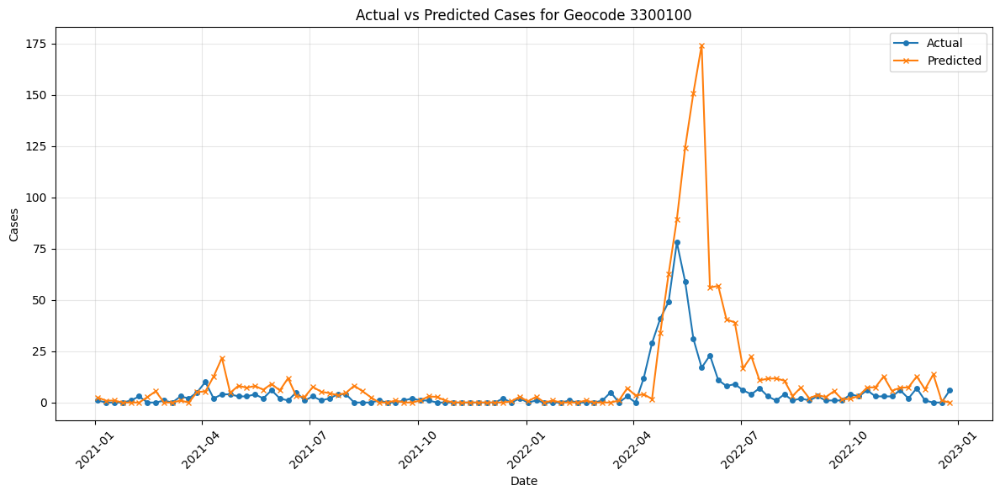

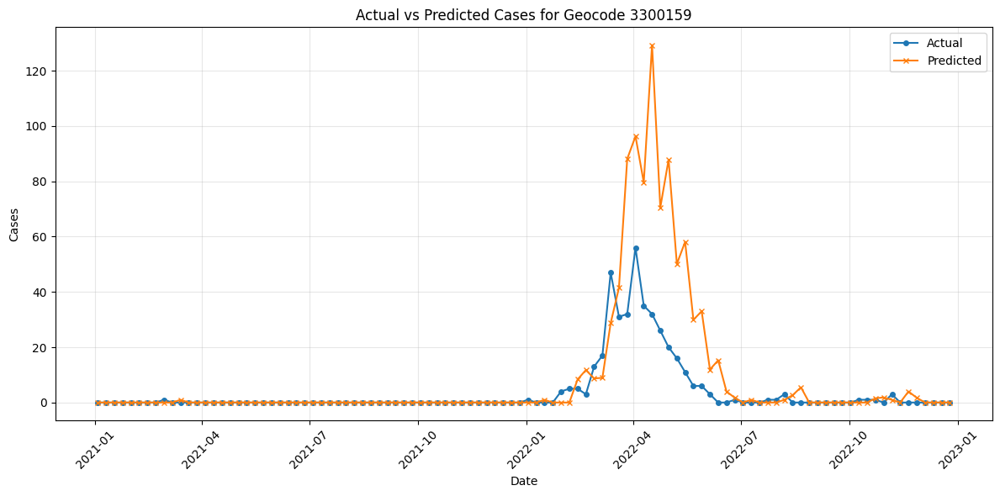

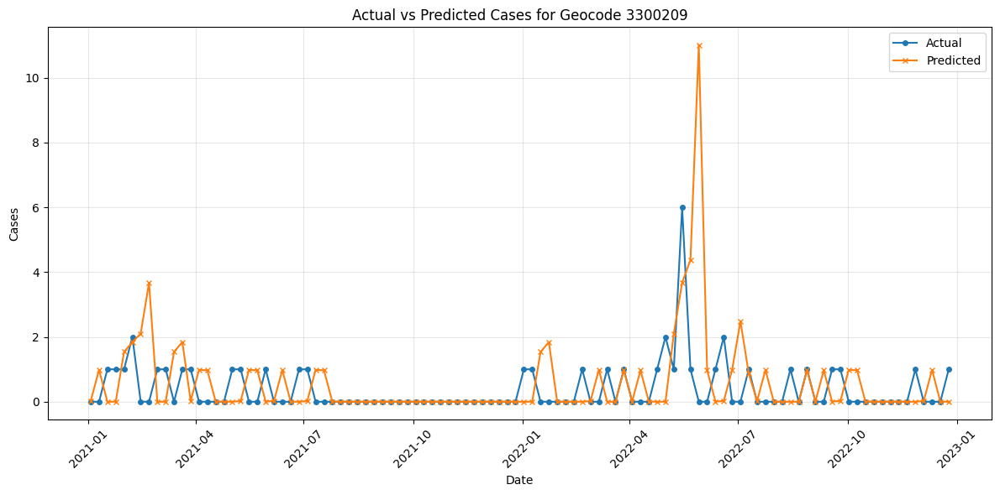

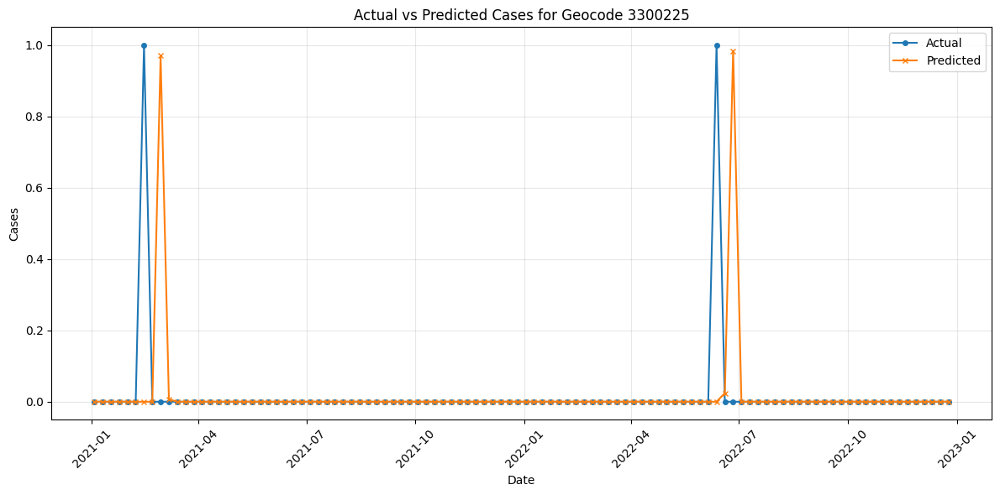

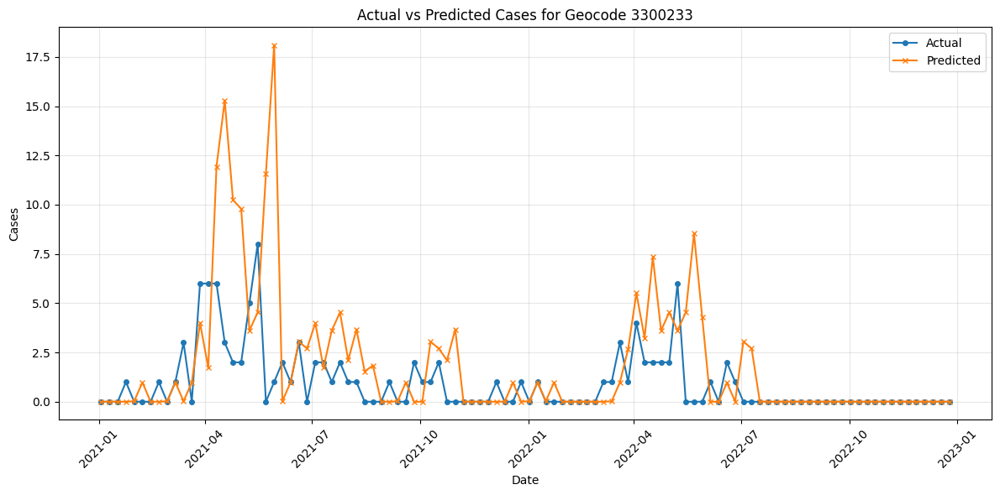

...

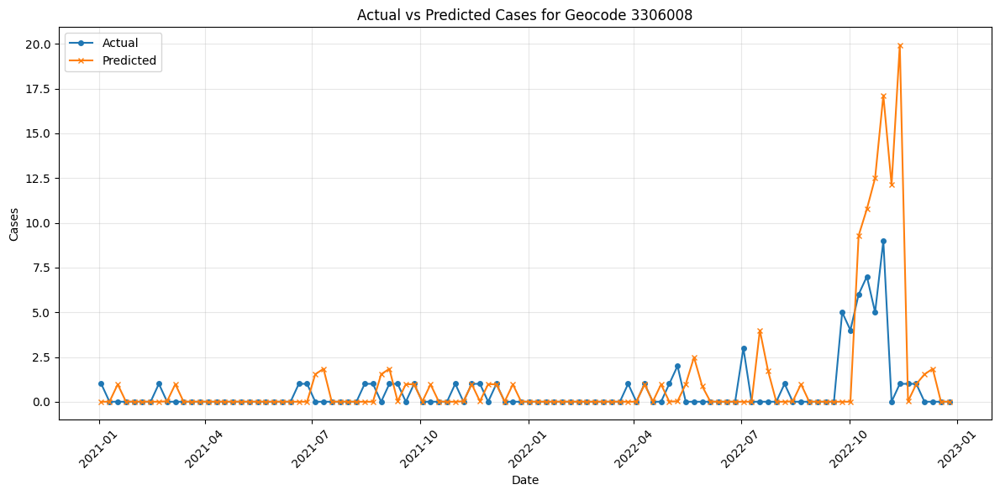

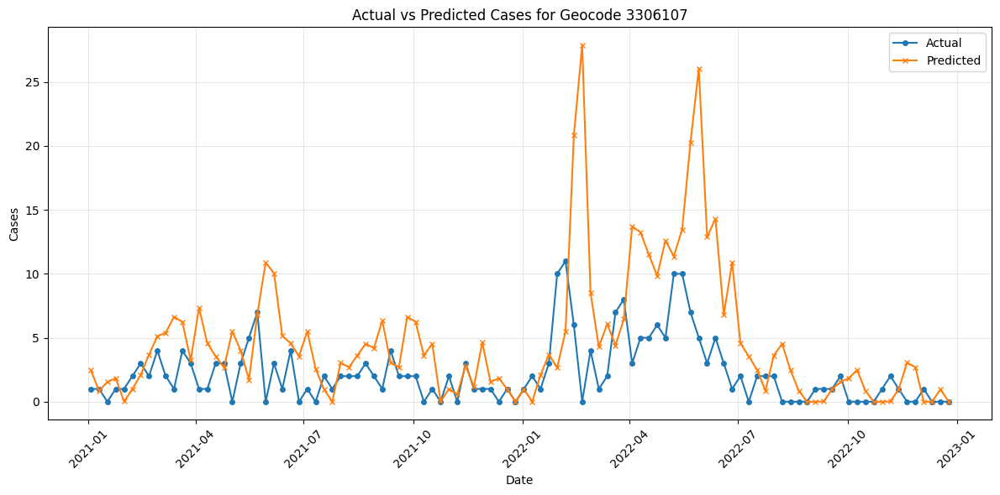

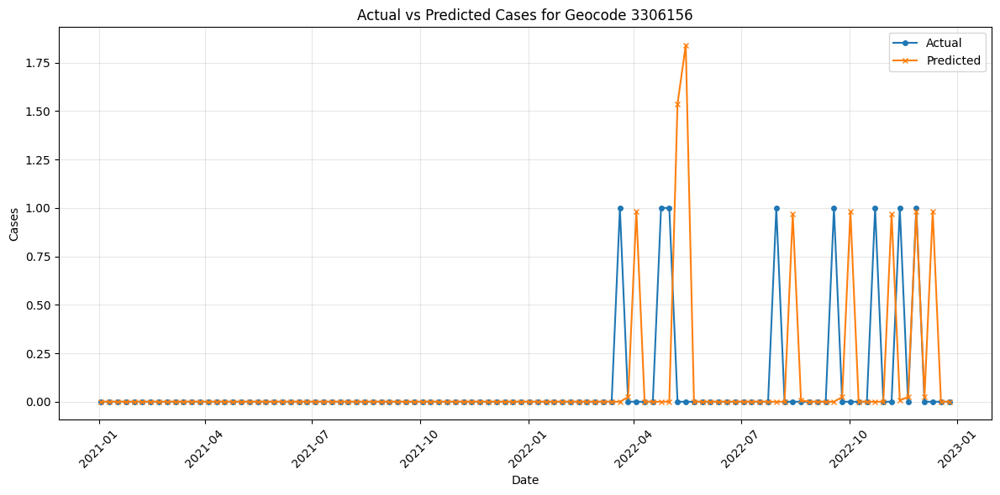

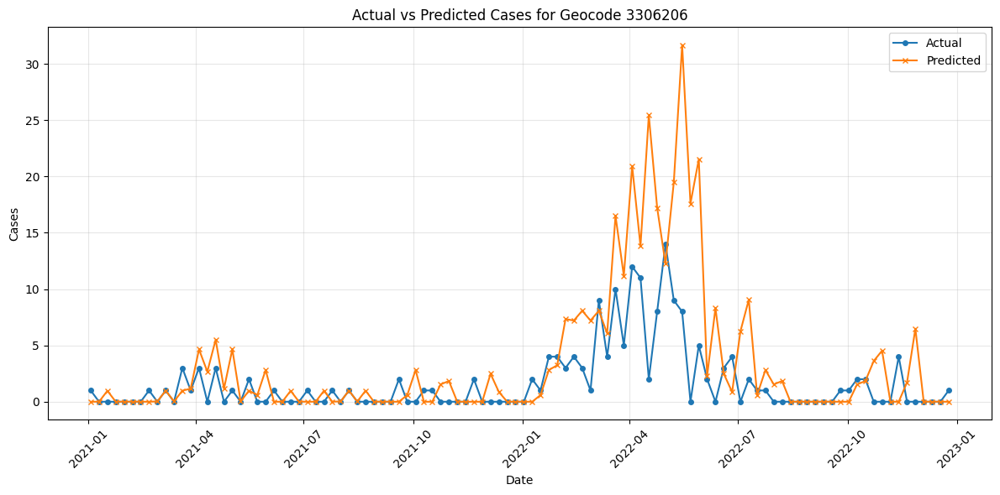

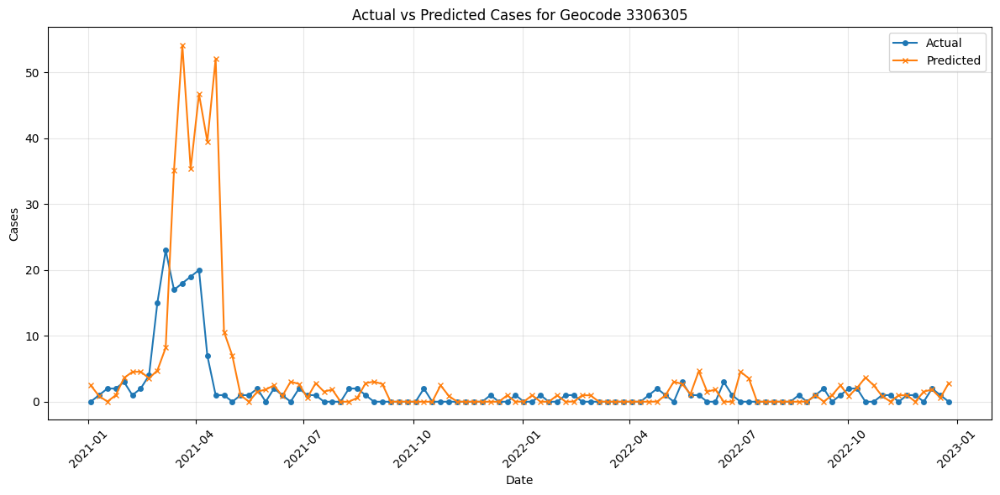

In [7]:

# Load and prepare data (same as before up to model fitting)
df = pd.read_csv('final_combined_dataset.csv', parse_dates=["date"])

# Keep important features
columns_to_drop = ['nearby_cases_weighted', 'city', 'week', 'population',
                  'vim', 'vim_monthly', 'long', 'lat', 'cases_per_100k',
                  'precipitation_max_ordinary_kriging', 'precipitation_max_regression_kriging',
                  'precipitation_avg_regression_kriging']
df = df.drop(columns=columns_to_drop)

# Feature Engineering
df['date'] = pd.to_datetime(df['date'])
df.set_index(['geocode', 'date'], inplace=True)

# Add Rio-specific seasonal components - simplified
df['month'] = df.index.get_level_values('date').month
# df['is_wet_season'] = np.where(df['month'].isin([11, 12, 1, 2, 3, 4]), 1, 0)
# df['is_dengue_season'] = df['month'].isin([3, 4, 5]).astype(int)

# Add moving averages and lagged features
df['cases_ma7'] = df.groupby('geocode')['cases'].transform(
    lambda x: x.rolling(window=7, min_periods=1).mean())
df['cases_lag1'] = df.groupby('geocode')['cases'].shift(1)
df['cases_lag2'] = df.groupby('geocode')['cases'].shift(2)

# Add threshold-based features
df['cases_mean'] = df.groupby('geocode')['cases'].transform('mean')
df['cases_std'] = df.groupby('geocode')['cases'].transform('std')
df['above_threshold'] = (df['cases'] > (df['cases_mean'] + 2*df['cases_std'])).astype(int)
df['recent_outbreak'] = df.groupby('geocode')['above_threshold'].transform(
    lambda x: x.rolling(window=4, min_periods=1).sum() > 0).astype(int)

# Add selected interaction terms
# df['temp_wet'] = df['temp_avg'] * df['is_wet_season']
# df['humidity_wet'] = df['humidity_avg'] * df['is_wet_season']

# Drop rows with missing values
df.dropna(inplace=True)

# Define features for the model
feature_columns = [
    'cases_lag1', 
    'cases_lag2', 
    # 'cases_ma7',
    # 'temp_avg',
    # 'humidity_avg',
    # 'precipitation_avg_ordinary_kriging',
    # 'is_wet_season',
    # 'is_dengue_season',
    # 'recent_outbreak',
    # 'temp_wet',
    # 'humidity_wet'
]

# Split data into train and test
train_data = df[df.index.get_level_values('date') < '2021']
test_data = df[df.index.get_level_values('date') >= '2021']

# Prepare training data
y_train = train_data['cases']
X_train = sm.add_constant(train_data[feature_columns])

# Fit the model
model = PanelOLS(y_train, X_train, entity_effects=True)
result = model.fit()

print("\nModel Summary:")
print(result.summary)

# Modified rolling forecast function
def rolling_forecast(data, model_result, features, window_size=2):
    predictions = []
    
    for geocode in data.index.get_level_values('geocode').unique():
        geocode_data = data.xs(geocode, level='geocode')
        
        # Process each window
        for i in range(0, len(geocode_data) - window_size + 1, window_size):
            window = geocode_data.iloc[i:i+window_size].copy()
            
            # Initialize dictionary to store predictions for this window
            window_predictions = {}
            
            # Process each time step in the window
            for step in range(window_size):
                current_date = window.index[step]
                
                # Create prediction data for current step
                pred_data = window.iloc[step:step+1][features].copy()
                
                # Update lagged features based on previous predictions
                if step > 0:  # For steps after first prediction
                    # Update cases_lag1 with previous step's prediction
                    pred_data['cases_lag1'] = window_predictions[window.index[step-1]]
                    
                if step > 1:  # For steps after second prediction
                    # Update cases_lag2 with prediction from 2 steps ago
                    pred_data['cases_lag2'] = window_predictions[window.index[step-2]]
                
                # Update cases_ma7 based on available actual and predicted values
                # recent_values = []
                # # Add actual values from before the window
                # if i + step >= 7:
                #     recent_values.extend(geocode_data.iloc[i+step-7:i+step]['cases'].tolist())
                # else:
                #     recent_values.extend(geocode_data.iloc[max(0, i+step-7):i+step]['cases'].tolist())
                
                # # Add predictions from within the window
                # for prev_step in range(step):
                #     recent_values.append(window_predictions[window.index[prev_step]])
                
                # if recent_values:
                #     pred_data['cases_ma7'] = sum(recent_values) / len(recent_values)
                
                # Prepare data for prediction
                pred_data = pred_data.assign(const=1.0)
                pred_data.index = pd.MultiIndex.from_product(
                    [[geocode], [current_date]],
                    names=['geocode', 'date']
                )
                
                # Make prediction
                pred = result.predict(pred_data)
                predicted_value = max(0, pred['predictions'].iloc[0])  # Ensure non-negative
                
                # Store prediction for this step
                window_predictions[current_date] = predicted_value
                
                # Store results
                predictions.append({
                    'geocode': geocode,
                    'date': current_date,
                    'predicted_cases': predicted_value,
                    'actual_cases': window.loc[current_date, 'cases']
                })
    
    return pd.DataFrame(predictions)

# Generate predictions
predicted_df = rolling_forecast(test_data, result, feature_columns)
print(predicted_df)
# Calculate evaluation metrics
predicted_df['error'] = predicted_df['actual_cases'] - predicted_df['predicted_cases']
predicted_df['abs_error'] = abs(predicted_df['error'])
predicted_df['squared_error'] = predicted_df['error'] ** 2

print("\nEvaluation Metrics:")
print(f"Mean Absolute Error: {predicted_df['abs_error'].mean():.2f}")
print(f"Root Mean Squared Error: {np.sqrt(predicted_df['squared_error'].mean()):.2f}")
print(f"Mean Absolute Percentage Error: {mean_absolute_percentage_error(predicted_df['actual_cases'], predicted_df['predicted_cases']):.4f}")

# Visualization function
def plot_predictions(geocode):
    geocode_data = predicted_df[predicted_df['geocode'] == geocode].sort_values('date')
    
    plt.figure(figsize=(12, 6))
    plt.plot(geocode_data['date'], geocode_data['actual_cases'], 
             label='Actual', marker='o', markersize=4)
    plt.plot(geocode_data['date'], geocode_data['predicted_cases'], 
             label='Predicted', marker='x', markersize=4)
    
    plt.title(f'Actual vs Predicted Cases for Geocode {geocode}')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each geocode
for geocode in predicted_df['geocode'].unique():
    plot_predictions(geocode)




Model Summary:
                          PanelOLS Estimation Summary                           
Dep. Variable:                  cases   R-squared:                        0.9728
Estimator:                   PanelOLS   R-squared (Between):              0.9992
No. Observations:               42588   R-squared (Within):               0.9728
Date:                Thu, Feb 13 2025   R-squared (Overall):              0.9759
Time:                        13:51:11   Log-likelihood                -2.129e+05
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                   7.603e+05
Entities:                          91   P-value                           0.0000
Avg Obs:                       468.00   Distribution:                 F(2,42495)
Min Obs:                       468.00                                           
Max Obs:                       468.00   F-statistic (robust):          7.603e+05
            

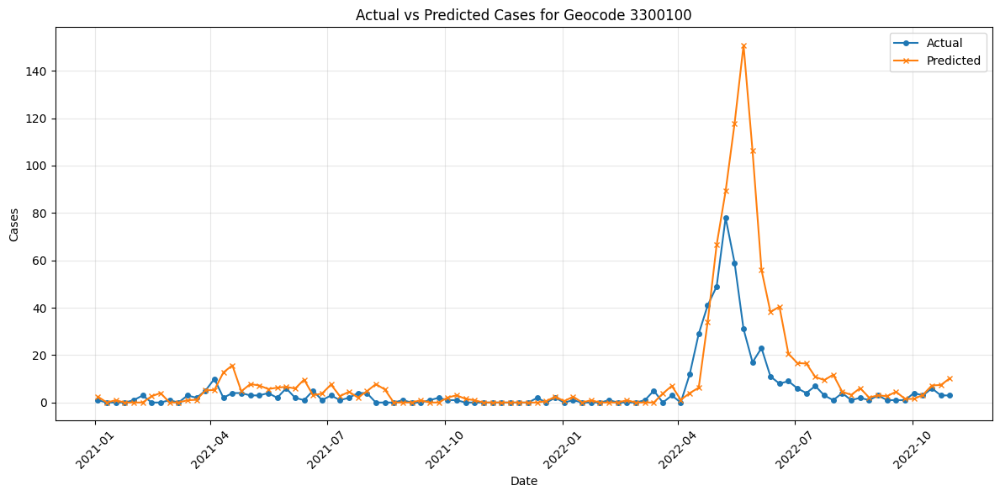

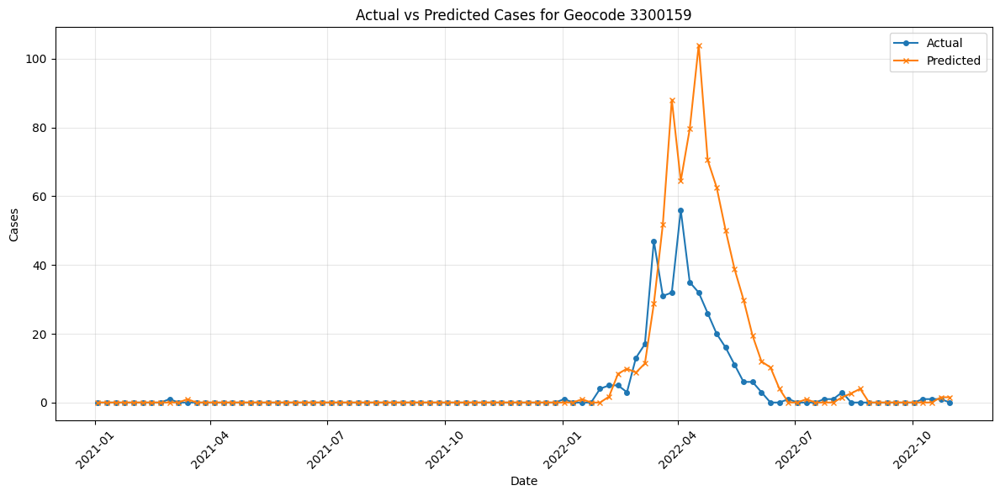

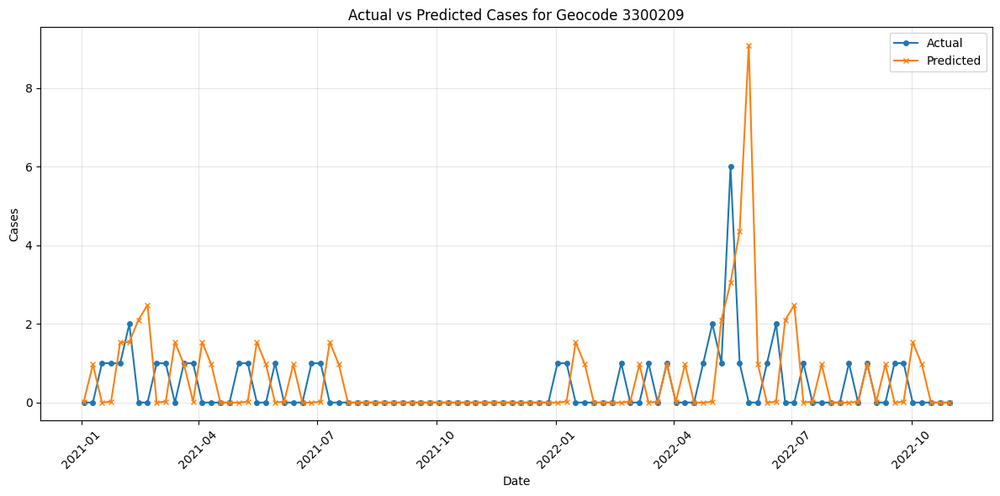

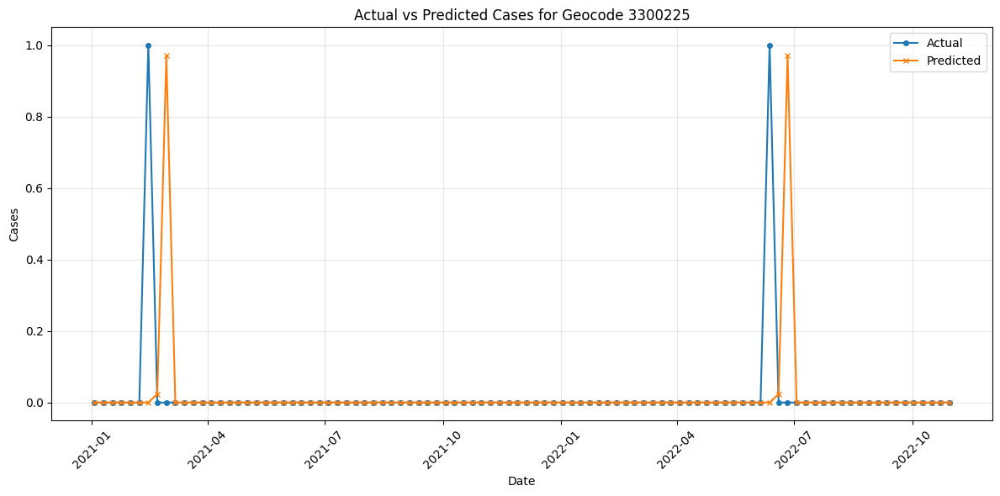

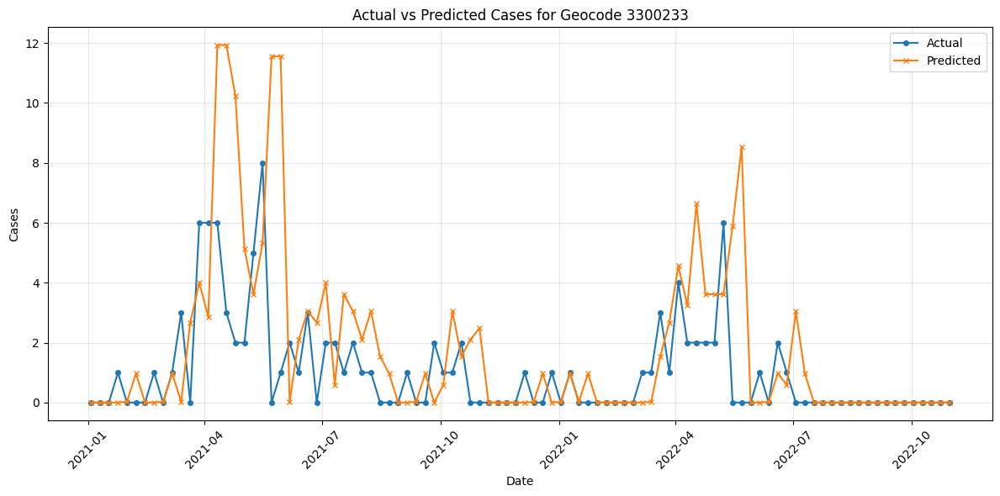

...

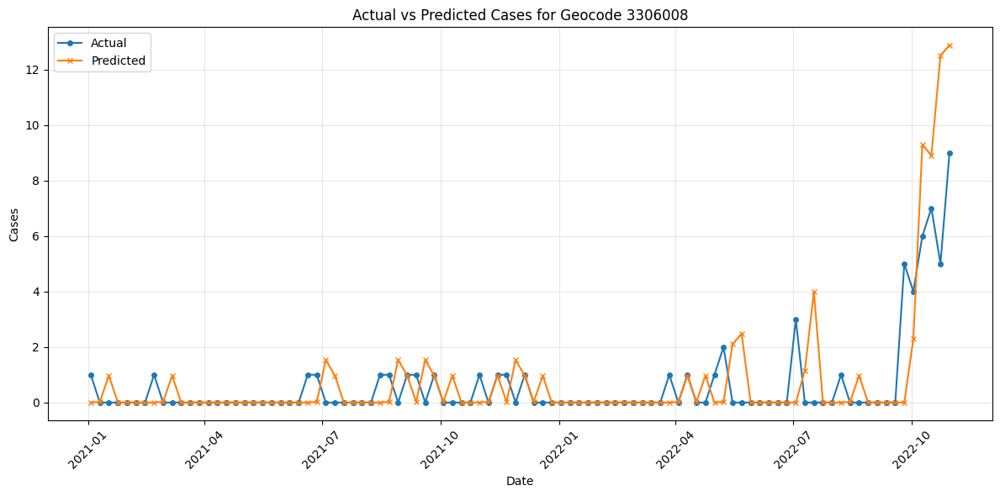

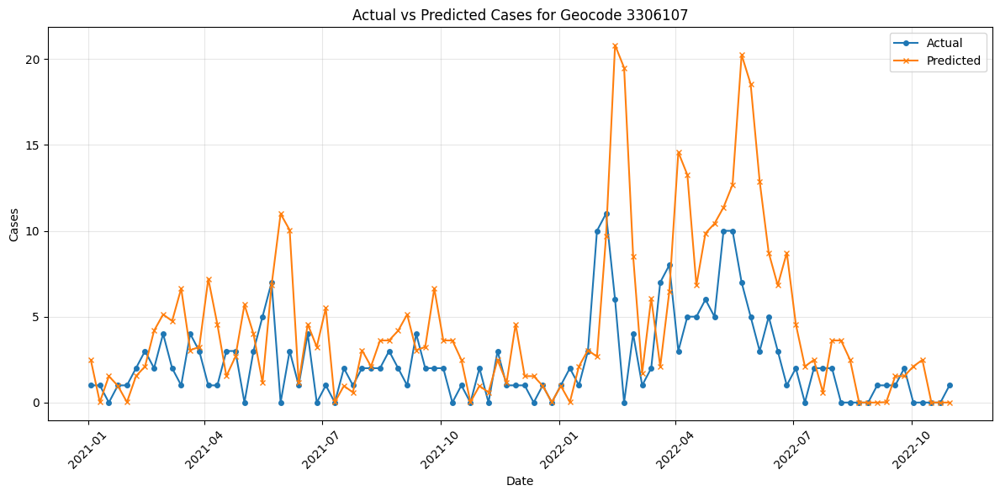

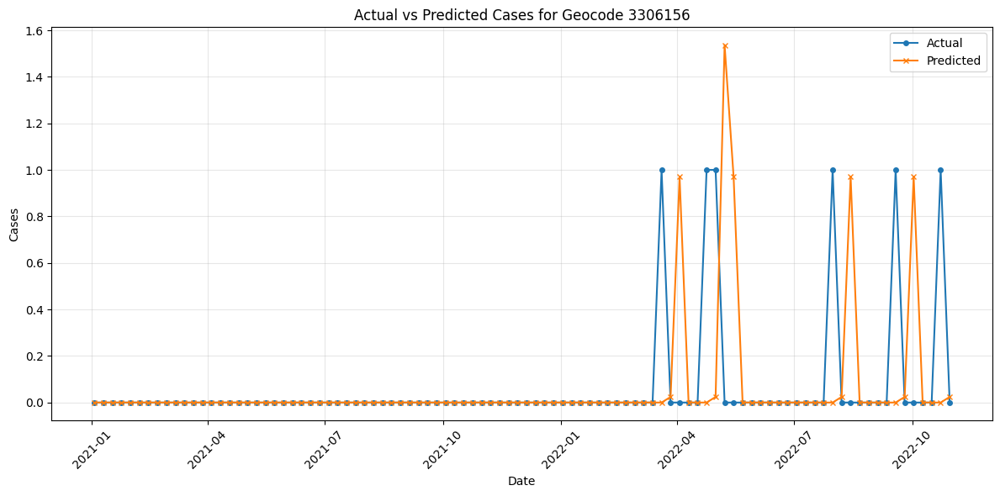

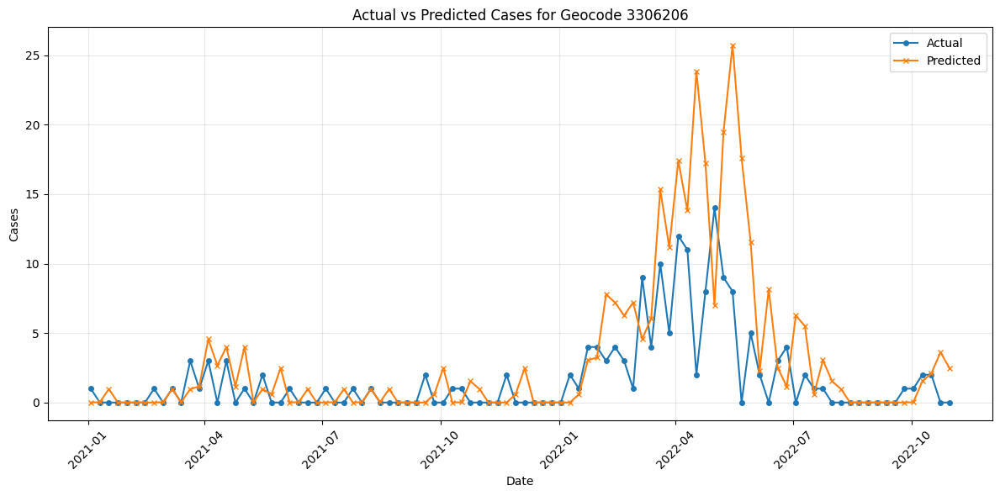

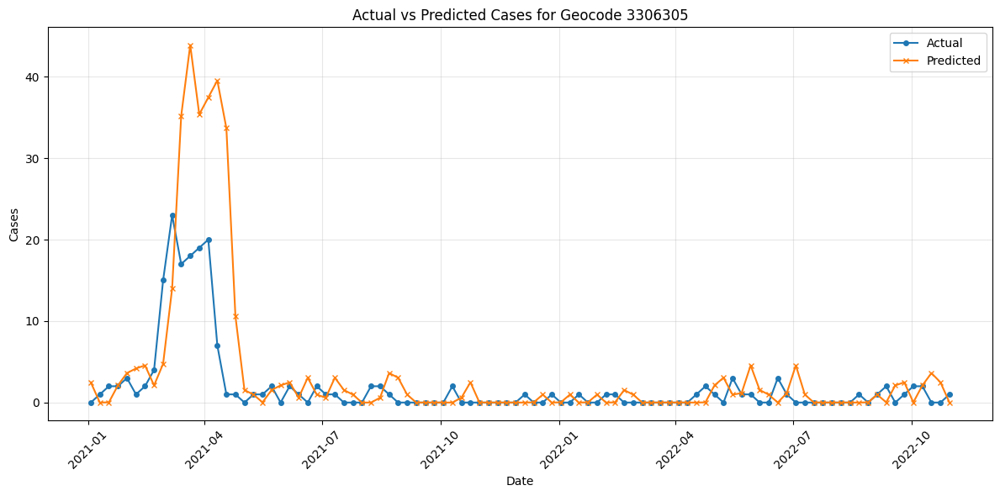

In [ ]:

# Load and prepare data (same as before up to model fitting)
df = pd.read_csv('final_combined_dataset.csv', parse_dates=["date"])

# Keep important features
columns_to_drop = ['nearby_cases_weighted', 'city', 'week', 'population',
                  'vim', 'vim_monthly', 'long', 'lat', 'cases_per_100k',
                  'precipitation_max_ordinary_kriging', 'precipitation_max_regression_kriging',
                  'precipitation_avg_regression_kriging']
df = df.drop(columns=columns_to_drop)

# Feature Engineering
df['date'] = pd.to_datetime(df['date'])
df.set_index(['geocode', 'date'], inplace=True)

# Add Rio-specific seasonal components - simplified
df['month'] = df.index.get_level_values('date').month
# df['is_wet_season'] = np.where(df['month'].isin([11, 12, 1, 2, 3, 4]), 1, 0)
# df['is_dengue_season'] = df['month'].isin([3, 4, 5]).astype(int)

# Add moving averages and lagged features
df['cases_ma7'] = df.groupby('geocode')['cases'].transform(
    lambda x: x.rolling(window=7, min_periods=1).mean())
df['cases_lag1'] = df.groupby('geocode')['cases'].shift(1)
df['cases_lag2'] = df.groupby('geocode')['cases'].shift(2)

# Add threshold-based features
df['cases_mean'] = df.groupby('geocode')['cases'].transform('mean')
df['cases_std'] = df.groupby('geocode')['cases'].transform('std')
df['above_threshold'] = (df['cases'] > (df['cases_mean'] + 2*df['cases_std'])).astype(int)
df['recent_outbreak'] = df.groupby('geocode')['above_threshold'].transform(
    lambda x: x.rolling(window=4, min_periods=1).sum() > 0).astype(int)

# Add selected interaction terms
# df['temp_wet'] = df['temp_avg'] * df['is_wet_season']
# df['humidity_wet'] = df['humidity_avg'] * df['is_wet_season']

# Drop rows with missing values
df.dropna(inplace=True)

# Define features for the model
feature_columns = [
    'cases_lag1', 
    'cases_lag2', 
    'cases_ma7',
    # 'temp_avg',
    # 'humidity_avg',
    # 'precipitation_avg_ordinary_kriging',
    # 'is_wet_season',
    # 'is_dengue_season',
    # 'recent_outbreak',
    # 'temp_wet',
    # 'humidity_wet'
]

# Split data into train and test
train_data = df[df.index.get_level_values('date') < '2021']
test_data = df[df.index.get_level_values('date') >= '2021']

# Prepare training data
y_train = train_data['cases']
X_train = sm.add_constant(train_data[feature_columns])

# Fit the model
model = PanelOLS(y_train, X_train, entity_effects=True)
result = model.fit()

print("\nModel Summary:")
print(result.summary)

# Modified rolling forecast function
def rolling_forecast(data, model_result, features, window_size=12):
    predictions = []
    
    for geocode in data.index.get_level_values('geocode').unique():
        geocode_data = data.xs(geocode, level='geocode')
        
        # Process each window
        for i in range(0, len(geocode_data) - window_size + 1, window_size):
            window = geocode_data.iloc[i:i+window_size]
            
            # Create a DataFrame with MultiIndex for prediction
            pred_data = window[features].copy()
            pred_data = pred_data.assign(const=1.0)  # Add constant
            # Ensure the index is properly set as MultiIndex
            pred_data.index = pd.MultiIndex.from_product(
                [[geocode], window.index],
                names=['geocode', 'date']
            )
            
            # Make predictions
            
            pred = result.predict(pred_data)  
                # Store results
            for date, predicted in zip(window.index, pred['predictions']):
                    predictions.append({
                        'geocode': geocode,
                        'date': date,
                        'predicted_cases': max(0, predicted),  # Ensure non-negative
                        'actual_cases': window.loc[date, 'cases']
                    })
            
    
    return pd.DataFrame(predictions)

# Generate predictions
predicted_df = rolling_forecast(test_data, result, feature_columns)
print(predicted_df)
# Calculate evaluation metrics
predicted_df['error'] = predicted_df['actual_cases'] - predicted_df['predicted_cases']
predicted_df['abs_error'] = abs(predicted_df['error'])
predicted_df['squared_error'] = predicted_df['error'] ** 2

print("\nEvaluation Metrics:")
print(f"Mean Absolute Error: {predicted_df['abs_error'].mean():.2f}")
print(f"Root Mean Squared Error: {np.sqrt(predicted_df['squared_error'].mean()):.2f}")
print(f"Mean Absolute Percentage Error: {mean_absolute_percentage_error(predicted_df['actual_cases'], predicted_df['predicted_cases']):.4f}")

# Visualization function
def plot_predictions(geocode):
    geocode_data = predicted_df[predicted_df['geocode'] == geocode].sort_values('date')
    
    plt.figure(figsize=(12, 6))
    plt.plot(geocode_data['date'], geocode_data['actual_cases'], 
             label='Actual', marker='o', markersize=4)
    plt.plot(geocode_data['date'], geocode_data['predicted_cases'], 
             label='Predicted', marker='x', markersize=4)
    
    plt.title(f'Actual vs Predicted Cases for Geocode {geocode}')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each geocode
for geocode in predicted_df['geocode'].unique():
    plot_predictions(geocode)



In [ ]:
# Load and prepare data (same as before up to model fitting)
df = pd.read_csv('final_combined_dataset.csv', parse_dates=["date"])

# Keep important features
columns_to_drop = ['nearby_cases_weighted', 'city', 'week', 'population',
                  'vim', 'vim_monthly', 'long', 'lat', 'cases_per_100k',
                  'precipitation_max_ordinary_kriging', 'precipitation_max_regression_kriging',
                  'precipitation_avg_regression_kriging']
df = df.drop(columns=columns_to_drop)

# Feature Engineering
df['date'] = pd.to_datetime(df['date'])
df.set_index(['geocode', 'date'], inplace=True)

# Add Rio-specific seasonal components - simplified
df['month'] = df.index.get_level_values('date').month
df['is_wet_season'] = np.where(df['month'].isin([11, 12, 1, 2, 3, 4]), 1, 0)
df['is_dengue_season'] = df['month'].isin([3, 4, 5]).astype(int)

# Add moving averages and lagged features
df['cases_ma7'] = df.groupby('geocode')['cases'].transform(
    lambda x: x.rolling(window=7, min_periods=1).mean())
df['cases_lag1'] = df.groupby('geocode')['cases'].shift(1)
df['cases_lag2'] = df.groupby('geocode')['cases'].shift(2)

# Add threshold-based features
df['cases_mean'] = df.groupby('geocode')['cases'].transform('mean')
df['cases_std'] = df.groupby('geocode')['cases'].transform('std')
df['above_threshold'] = (df['cases'] > (df['cases_mean'] + 2*df['cases_std'])).astype(int)
df['recent_outbreak'] = df.groupby('geocode')['above_threshold'].transform(
    lambda x: x.rolling(window=4, min_periods=1).sum() > 0).astype(int)

# Add selected interaction terms
df['temp_wet'] = df['temp_avg'] * df['is_wet_season']
df['humidity_wet'] = df['humidity_avg'] * df['is_wet_season']

# Drop rows with missing values
df.dropna(inplace=True)

# Define features for the model
feature_columns = [
    'cases_lag1', 
    'cases_lag2', 
    'cases_ma7',
    'temp_avg',
    'humidity_avg',
    'precipitation_avg_ordinary_kriging',
    'is_wet_season',
    'is_dengue_season',
    'recent_outbreak',
    'temp_wet',
    'humidity_wet'
]

# Split data into train and test
train_data = df[df.index.get_level_values('date') < '2021']
test_data = df[df.index.get_level_values('date') >= '2021']

# Prepare training data
y_train = train_data['cases']
X_train = sm.add_constant(train_data[feature_columns])

# Fit the model
model = PanelOLS(y_train, X_train, entity_effects=True)
result = model.fit()

print("\nModel Summary:")
print(result.summary)

# Modified rolling forecast function
def rolling_forecast(data, model_result, features, window_size=12):
    predictions = []
    
    for geocode in data.index.get_level_values('geocode').unique():
        geocode_data = data.xs(geocode, level='geocode')
        
        # Process each window
        for i in range(0, len(geocode_data) - window_size + 1, window_size):
            window = geocode_data.iloc[i:i+window_size]
            
            # Create a DataFrame with MultiIndex for prediction
            pred_data = window[features].copy()
            pred_data = pred_data.assign(const=1.0)  # Add constant
            
            # Ensure the index is properly set as MultiIndex
            pred_data.index = pd.MultiIndex.from_tuples(
                 [(geocode, date) for date in window.index],
                 names=['geocode', 'date']
            )
            
            # Make predictions
                
            pred = result.predict(pred_data)
                    
                    # Store results
            for date, predicted in zip(window.index, pred):
                        predictions.append({
                            'geocode': geocode,
                            'date': date,
                            'predicted_cases': max(0, predicted),  # Ensure non-negative
                            'actual_cases': window.loc[date, 'cases']
                        })
            
    
    return pd.DataFrame(predictions)

# Generate predictions
predicted_df = rolling_forecast(test_data, result, feature_columns)

# Calculate evaluation metrics
predicted_df['error'] = predicted_df['actual_cases'] - predicted_df['predicted_cases']
predicted_df['abs_error'] = abs(predicted_df['error'])
predicted_df['squared_error'] = predicted_df['error'] ** 2

print("\nEvaluation Metrics:")
print(f"Mean Absolute Error: {predicted_df['abs_error'].mean():.2f}")
print(f"Root Mean Squared Error: {np.sqrt(predicted_df['squared_error'].mean()):.2f}")
print(f"Mean Absolute Percentage Error: {mean_absolute_percentage_error(predicted_df['actual_cases'], predicted_df['predicted_cases']):.4f}")

# Visualization function
def plot_predictions(geocode):
    geocode_data = predicted_df[predicted_df['geocode'] == geocode].sort_values('date')
    
    plt.figure(figsize=(12, 6))
    plt.plot(geocode_data['date'], geocode_data['actual_cases'], 
             label='Actual', marker='o', markersize=4)
    plt.plot(geocode_data['date'], geocode_data['predicted_cases'], 
             label='Predicted', marker='x', markersize=4)
    
    plt.title(f'Actual vs Predicted Cases for Geocode {geocode}')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Plot for each geocode
for geocode in predicted_df['geocode'].unique():
    plot_predictions(geocode)


Model Summary:
                          PanelOLS Estimation Summary                           
Dep. Variable:                  cases   R-squared:                        0.9734
Estimator:                   PanelOLS   R-squared (Between):              0.9984
No. Observations:               42588   R-squared (Within):               0.9734
Date:                Thu, Feb 13 2025   R-squared (Overall):              0.9763
Time:                        11:19:26   Log-likelihood                -2.124e+05
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                   1.411e+05
Entities:                          91   P-value                           0.0000
Avg Obs:                       468.00   Distribution:                F(11,42486)
Min Obs:                       468.00                                           
Max Obs:                       468.00   F-statistic (robust):          1.411e+05
            

TypeError: '>' not supported between instances of 'str' and 'int'